Start by creating a new `conda` environment:

```bash
$ conda create -n pyannote python=3.6 anaconda
$ source activate pyannote
```

Then, install `pyannote-video` and its dependencies:

```bash
$ pip install pyannote-video
```

Finally, download sample video and `dlib` models:

```bash
$ git clone https://github.com/pyannote/pyannote-data.git
$ git clone https://github.com/davisking/dlib-models.git
$ bunzip2 dlib-models/dlib_face_recognition_resnet_model_v1.dat.bz2
$ bunzip2 dlib-models/shape_predictor_68_face_landmarks.dat.bz2
```

To execute this notebook locally:
```bash
$ git clone https://github.com/pyannote/pyannote-video.git
$ jupyter notebook --notebook-dir="pyannote-video/doc"
```


In [1]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


## Path to the files

#### List of the title of videos

In [2]:
import os
os.listdir('./datas')

['Les_varietes_resistantes___evaluation_sur_le_terrain',
 'VITIS_PROHIBITA___EXTRAIT_13',
 'VITIS_PROHIBITA___EXTRAIT_15',
 "Des_vignes_resistantes_au_mildiou_avec_l'INRA_de_Gruissan",
 'Laccave_seminaire_Ideoypes&Vins_de_demain_Eric_Giraud-Heraud',
 '17-_Colloque_DEPHY_Viticulture_-_Cepages_resistants',
 'VITIS_PROHIBITA___EXTRAIT_10',
 'VITIS_PROHIBITA___EXTRAIT_4',
 'Cepages_resistants']

#### Then, creating th path to the video, with one of the title below

The different path are like :

    - shots_path : for the shot segmentation
    - track_path : for the face tracking 
    - video_track_path : for the video with face tracking
    - landmarks_path : for the landmarks file
    - embedding_path : for the file containing embeddings
    - labels_path : for the label file, use to put labels on the clusters
    - video_final_path : for the final video with face tracking and clusturing
    

In [3]:
import pathlib


title = "Cepages_resistants" # title of the video which will be processed

# Creation of the different extension and the absolute path 
path = pathlib.Path().parent.absolute()
dir_path = str(path) +"/datas/" + title + "/"

shots_extension = ".shots.json"
track_extension = ".track.txt"
video_track_extension = ".track.mp4"
landmark_extension = ".landmarks.txt"
embedding_extension = ".embedding.txt"
labels_extension = ".labels.txt"
video_final_extension = ".final.mp4"

# Path of the video
video_path = dir_path + "../../../videos/" + title + "/" + title + ".mp4"

# Path to the different files that the process will create
shots_path = dir_path + title + shots_extension
track_path = dir_path + title + track_extension
video_track_path = dir_path + title + video_track_extension
landmarks_path = dir_path + title + landmark_extension
embedding_path = dir_path + title + embedding_extension
labels_path = dir_path + title + labels_extension 
video_final_path = dir_path + title + video_final_extension




# Shot segmentation

In [4]:
!pyannote-structure.py --help

Video structure

The standard pipeline for is the following:

    shot boundary detection ==> shot threading ==> segmentation into scenes

Usage:
  pyannote-structure.py shot [options] <video> <output.json>
  pyannote-structure.py thread [options] <video> <shot.json> <output.json>
  pyannote-structure.py scene [options] <video> <thread.json> <output.json>
  pyannote-structure.py (-h | --help)
  pyannote-structure.py --version

Options:
  --ffmpeg=<ffmpeg>      Specify which `ffmpeg` to use.
  --height=<n_pixels>    Resize video frame to height <n_pixels> [default: 50].
  --window=<n_seconds>   Apply median filtering on <n_seconds> window [default: 2.0].
  --threshold=<value>    Set threshold to <value> [default: 1.0].
  --min-match=<n_match>  Set minimum number of matches to <n_match> [default: 20].
  --lookahead=<n_shots>  Look at up to <n_shots> following shots [default: 24].
  -h --help              Show this screen.
  --version              Show version.
  --verbose              Sh

In [5]:
print(video_path)
!pyannote-structure.py shot --verbose $video_path $shots_path



/home/yoanwm/Documents/TER/TER-Evaluation-Transcription-automatique-d-audio/faceDetection/datas/Cepages_resistants/../../../videos/Cepages_resistants/Cepages_resistants.mp4
2.63kframes [01:44, 25.3frames/s]                                               


Detected shot boundaries can be visualized using `pyannote.core` notebook support:

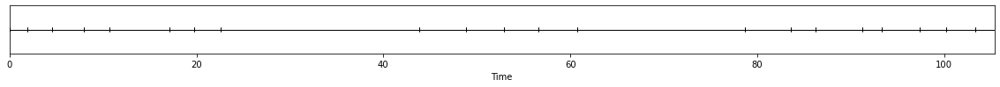

In [6]:
from pyannote.core.json import load_from
shots = load_from(shots_path)
shots

#cv2.imwrite(dir_path+title+'.shots.png', shots)

# Face processing


In [7]:
!pyannote-face.py --help

Face detection and tracking

The standard pipeline is the following

      face tracking => feature extraction => face clustering

Usage:
  pyannote-face track [options] <video> <shot.json> <tracking>
  pyannote-face extract [options] <video> <tracking> <landmark_model> <embedding_model> <landmarks> <embeddings>
  pyannote-face demo [options] <video> <tracking> <output>
  pyannote-face (-h | --help)
  pyannote-face --version

General options:

  --ffmpeg=<ffmpeg>         Specify which `ffmpeg` to use.
  -h --help                 Show this screen.
  --version                 Show version.
  --verbose                 Show processing progress.

Face tracking options (track):

  <video>                   Path to video file.
  <shot.json>               Path to shot segmentation result file.
  <tracking>                Path to tracking result file.

  --min-size=<ratio>        Approximate size (in video height ratio) of the
                            smallest face that should be detected. D

### Face tracking

In [8]:
!pyannote-face.py track --verbose --every=0.5 $video_path \
                                                $shots_path $track_path

2.63kframes [02:27, 17.8frames/s]                                               


Face tracks can be visualized using `demo` mode:

In [9]:
!pyannote-face.py demo $video_path $track_path $video_track_path

[MoviePy] >>>> Building video /home/yoanwm/Documents/TER/TER-Evaluation-Transcription-automatique-d-audio/faceDetection/datas/Cepages_resistants/Cepages_resistants.track.mp4
[MoviePy] Writing audio in Cepages_resistants.trackTEMP_MPY_wvf_snd.mp3
100%|█████████████████████████████████████| 2324/2324 [00:01<00:00, 1555.37it/s]
[MoviePy] Done.
[MoviePy] Writing video /home/yoanwm/Documents/TER/TER-Evaluation-Transcription-automatique-d-audio/faceDetection/datas/Cepages_resistants/Cepages_resistants.track.mp4
100%|███████████████████████████████████████| 2635/2635 [00:31<00:00, 84.90it/s]
[MoviePy] Done.
[MoviePy] >>>> Video ready: /home/yoanwm/Documents/TER/TER-Evaluation-Transcription-automatique-d-audio/faceDetection/datas/Cepages_resistants/Cepages_resistants.track.mp4 



In [10]:
import io
import base64
from IPython.display import HTML
video = io.open(video_track_path, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls><source src="data:video/mp4;base64,{0}" type="video/mp4" /></video>'''.format(encoded.decode('ascii')))

### Facial landmarks and face embedding

In [11]:
!pyannote-face.py extract --verbose $video_path \
                                    $track_path \
                                    ./dlib-models/shape_predictor_68_face_landmarks.dat \
                                    ./dlib-models/dlib_face_recognition_resnet_model_v1.dat \
                                    $landmarks_path \
                                    $embedding_path





2.63kframes [05:06, 8.60frames/s]                                               


### Face clustering

Once embeddings are extracted, let's apply face track hierarchical agglomerative clustering.  
The distance between two clusters is defined as the average euclidean distance between all embeddings.  

In [12]:
from pyannote.video.face.clustering import FaceClustering
clustering = FaceClustering(threshold=0.6)

/home/yoanwm/Documents/TER/TER-Evaluation-Transcription-automatique-d-audio/faceDetection/datas/Cepages_resistants/Cepages_resistants.embedding.txt


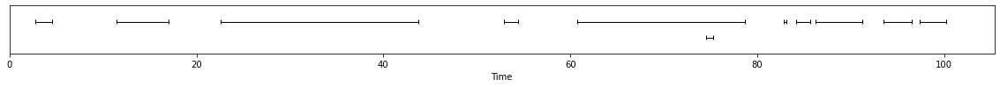

In [13]:
print(embedding_path)
face_tracks, embeddings = clustering.model.preprocess(embedding_path)
face_tracks.get_timeline()

In [14]:

result = clustering(face_tracks, features=embeddings)

`notebook.reset()` make a reset for the segment timeline, with the full timeline. But you have to run again the others sgmentation representation to get this timeline.

If you want a specific timeline, you can use `notebook.crop = Segment(begin, end)`.

For a mapping with specific labels, you can use : 

` mapping = {1 : 'Mr ...', ...}
result = result.rename_labels(mapping=mapping)`


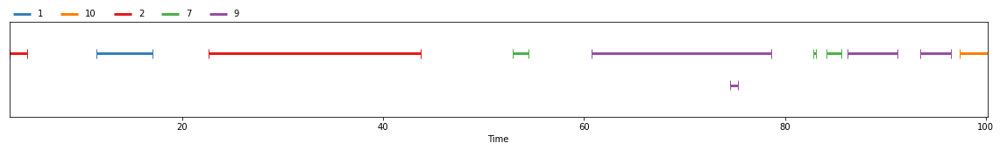

In [15]:
from pyannote.core import notebook, Segment
notebook.reset() 
    
#notebook.crop = Segment(0, 65) 

mapping = {} # Here you can name your labels. Ex : mapping = {1 : 'Mr ...', ...}
result = result.rename_labels(mapping=mapping)
result


In [16]:
with open(labels_path, 'w') as fp:
    for _, track_id, cluster in result.itertracks(yield_label=True):
        fp.write(f'{track_id} {cluster}\n')

In [17]:
!pyannote-face.py demo $video_path \
                       $track_path \
                       --label=$labels_path \
                       $video_final_path

[MoviePy] >>>> Building video /home/yoanwm/Documents/TER/TER-Evaluation-Transcription-automatique-d-audio/faceDetection/datas/Cepages_resistants/Cepages_resistants.final.mp4
[MoviePy] Writing audio in Cepages_resistants.finalTEMP_MPY_wvf_snd.mp3
100%|█████████████████████████████████████| 2324/2324 [00:01<00:00, 1542.68it/s]
[MoviePy] Done.
[MoviePy] Writing video /home/yoanwm/Documents/TER/TER-Evaluation-Transcription-automatique-d-audio/faceDetection/datas/Cepages_resistants/Cepages_resistants.final.mp4
100%|███████████████████████████████████████| 2635/2635 [00:29<00:00, 88.29it/s]
[MoviePy] Done.
[MoviePy] >>>> Video ready: /home/yoanwm/Documents/TER/TER-Evaluation-Transcription-automatique-d-audio/faceDetection/datas/Cepages_resistants/Cepages_resistants.final.mp4 



In [18]:
import io
import base64
from IPython.display import HTML
video = io.open(video_final_path, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls><source src="data:video/mp4;base64,{0}" type="video/mp4" /></video>'''.format(encoded.decode('ascii')))